In [1]:
from google.colab import drive
drive.mount('/drive')
%cd /drive/My Drive/tutorials

Drive already mounted at /drive; to attempt to forcibly remount, call drive.mount("/drive", force_remount=True).
/drive/My Drive/tutorials


In [0]:
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

import matplotlib.pyplot as plt
import numpy as np
import random

In [0]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5,),(0.5,)),
     ]# color 이미지의 경우 0.5,0.5,0.5
)

In [4]:
PATH = './data'
batch_size =128
workers = 2
epochs = 100
image_size=28*28
latent_size=100

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

manualSeed = 3734
print("Random Seed: ",manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  3734


In [0]:
train_set = torchvision.datasets.MNIST(root=PATH,train=True,
                                      download=True,transform=transform)
train_loader = torch.utils.data.DataLoader(train_set,batch_size=batch_size,
                                          shuffle =True, num_workers=workers)

test_set = torchvision.datasets.MNIST(root=PATH,train=False,
                                     download=True, transform=transform)

test_loader = torch.utils.data.DataLoader(test_set, batch_size=batch_size,
                                          shuffle = False, num_workers=workers)

train_iter = iter(train_loader)
test_iter = iter(test_loader)

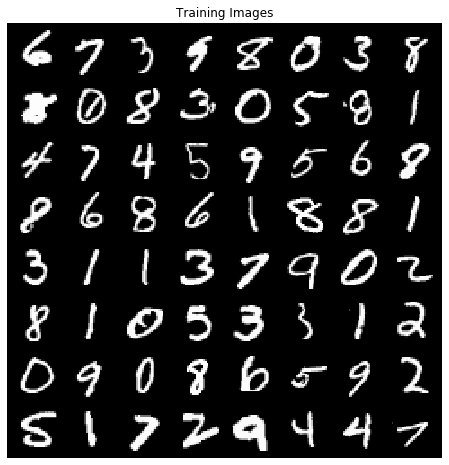

In [6]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64],padding=2, normalize=True).cpu(),(1,2,0)))

In [7]:
real_batch[0].size()

torch.Size([128, 1, 28, 28])

In [0]:
import torch.nn as nn
import torch.nn.functional as F

class G(nn.Module):
  def __init__(self):
    super(G,self).__init__()
    self.net=nn.Sequential(
        nn.Linear(latent_size,256),
        nn.ReLU(),
        nn.Linear(256,256),
        nn.ReLU(),
        nn.Linear(256, image_size),
        nn.Tanh()
    )

  def forward(self, z):
    z=self.net(z)
    return z

In [0]:
class D(nn.Module):
  def __init__(self):
    super(D,self).__init__()
    self.net=nn.Sequential(
        nn.Linear(image_size,256),
        nn.LeakyReLU(0.2),
        nn.Linear(256,256),
        nn.LeakyReLU(0.2),
        nn.Linear(256,1),
        nn.Sigmoid()
    )
  def forward(self, x):
    x=self.net(x)
    return x

In [0]:
import torch.optim as optim

G_net = G().to(device)
D_net = D().to(device)

criterion = nn.BCELoss()
G_optimizer = optim.Adam(G_net.parameters(),lr=0.0002,betas=(0.5,0.999))
D_optimizer = optim.Adam(D_net.parameters(),lr=0.0002,betas=(0.5,0.999))

real_label = 1
fake_label = 0


fixed_noise = torch.randn(batch_size, latent_size,device=device)

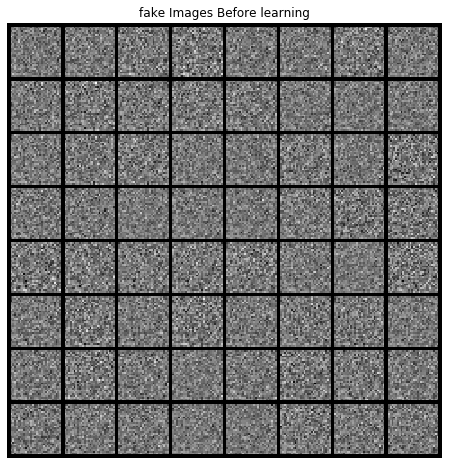

In [11]:
with torch.no_grad():
  fake_batch=G_net(fixed_noise)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('fake Images Before learning')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device)[:64].view(64,1,28,28),padding=2, normalize=True).cpu(),(1,2,0)))

In [0]:
img_list = []
G_losses = []
D_losses = []

In [13]:
for ep in range(epochs):
  for i, (data, _) in enumerate(train_loader):
    b_size=data.shape[0]

    data = data.reshape(b_size,-1).to(device)
    real_labels = torch.ones(b_size,1).to(device)
    fake_labels = torch.zeros(b_size,1).to(device)

    #Train D
    D_net.zero_grad()

    real_score = Dx = D_net(data)
    loss_Dx = criterion(Dx, real_labels)

    z = torch.randn(b_size,latent_size).to(device)
    Gz = G_net(z)
    fake_score = DGz = D_net(Gz.detach())

    loss_DGz = criterion(DGz,   fake_labels)

    loss_D = loss_Dx  + loss_DGz
    loss_D.backward()
    D_optimizer.step()

    #Train G
    G_net.zero_grad()
    DGz = D_net(Gz)
    
    loss_G = criterion(DGz, real_labels)

    loss_G.backward()
    G_optimizer.step()

    if (i+1)%200 == 0 or i==0:
      print('Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, D(G(z)): {:.2f}' 
            .format(ep, epochs, i+1, len(train_loader), loss_D.item(), loss_G.item(), 
                    real_score.mean().item(), fake_score.mean().item()))
      if i==0:
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
      with torch.no_grad():
        fake = G_net(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(torch.reshape(fake,(b_size,1,28,28))[:64], padding=2, normalize=True))



Epoch [0/100], Step [1/469], d_loss: 1.3013, g_loss: 0.6900, D(x): 0.55, D(G(z)): 0.50
Epoch [0/100], Step [200/469], d_loss: 1.1414, g_loss: 0.8715, D(x): 0.60, D(G(z)): 0.47
Epoch [0/100], Step [400/469], d_loss: 0.3264, g_loss: 2.7788, D(x): 0.96, D(G(z)): 0.25
Epoch [1/100], Step [1/469], d_loss: 0.3063, g_loss: 2.7912, D(x): 0.93, D(G(z)): 0.20
Epoch [1/100], Step [200/469], d_loss: 0.1464, g_loss: 3.4875, D(x): 0.97, D(G(z)): 0.09
Epoch [1/100], Step [400/469], d_loss: 0.2943, g_loss: 3.0155, D(x): 0.89, D(G(z)): 0.14
Epoch [2/100], Step [1/469], d_loss: 0.7917, g_loss: 2.4705, D(x): 0.58, D(G(z)): 0.02
Epoch [2/100], Step [200/469], d_loss: 0.3182, g_loss: 3.9234, D(x): 0.95, D(G(z)): 0.22
Epoch [2/100], Step [400/469], d_loss: 0.5203, g_loss: 2.3009, D(x): 0.74, D(G(z)): 0.04
Epoch [3/100], Step [1/469], d_loss: 0.5493, g_loss: 4.3813, D(x): 0.91, D(G(z)): 0.33
Epoch [3/100], Step [200/469], d_loss: 0.8142, g_loss: 2.6292, D(x): 0.58, D(G(z)): 0.01
Epoch [3/100], Step [400/469]

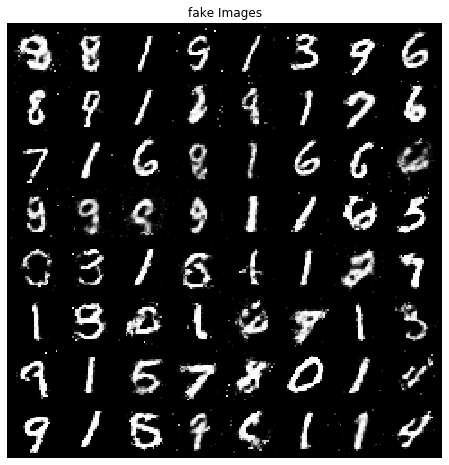

In [14]:
with torch.no_grad():
  fake_batch=G_net(fixed_noise)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('fake Images')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device)[:64].view(64,1,28,28),padding=2, normalize=True).cpu(),(1,2,0)))

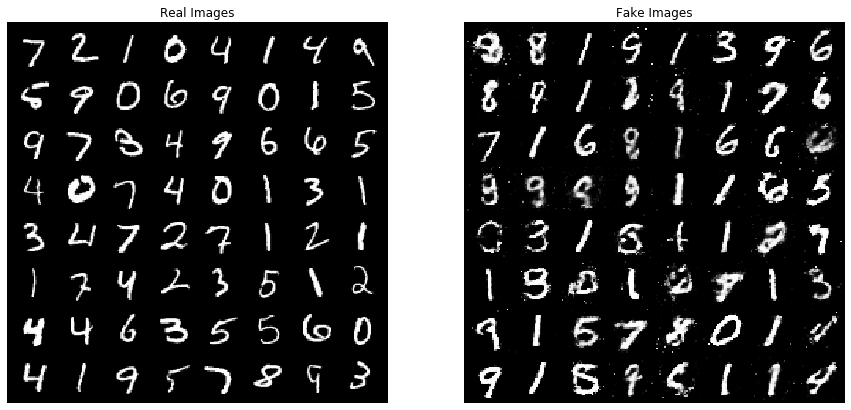

In [15]:
real_batch = next(iter(test_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Animation size has reached 21036152 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


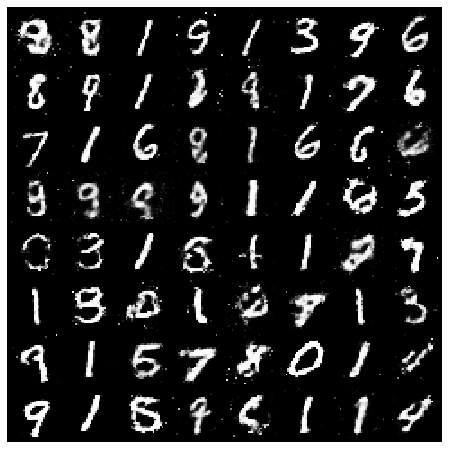

In [16]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [0]:
from PIL import Image
transform_PIL=transforms.ToPILImage()

p_img_list = [transform_PIL(p_image) for p_image in img_list]
p_img_list[0].save('vanillaGAN_mnist.gif', save_all=True,append_images=p_img_list[1:], optimize=False, duration=5, loop=0)

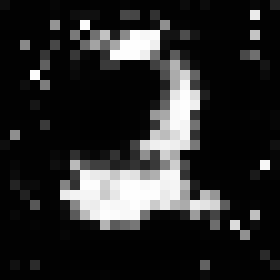

In [19]:
with torch.no_grad():
  random_noise=torch.randn(latent_size,device=device)
  fake=G_net(random_noise)
fake_image = fake.reshape(28,28)
fake_PIL_image = transform_PIL(fake_image)

resized_PIL_image=fake_PIL_image.resize((280,280))
resized_PIL_image

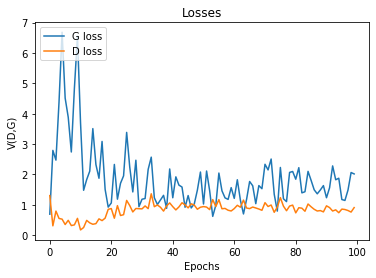

In [20]:
plt.title("Losses")
plt.plot(G_losses,label="G loss")
plt.plot(D_losses,label="D loss")
plt.legend(loc=2)
plt.ylabel("V(D,G)")
plt.xlabel("Epochs")
plt.show()